In [29]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import random 
import math

In [30]:
img_rgb = cv2.imread('real_test_1.jpg') 

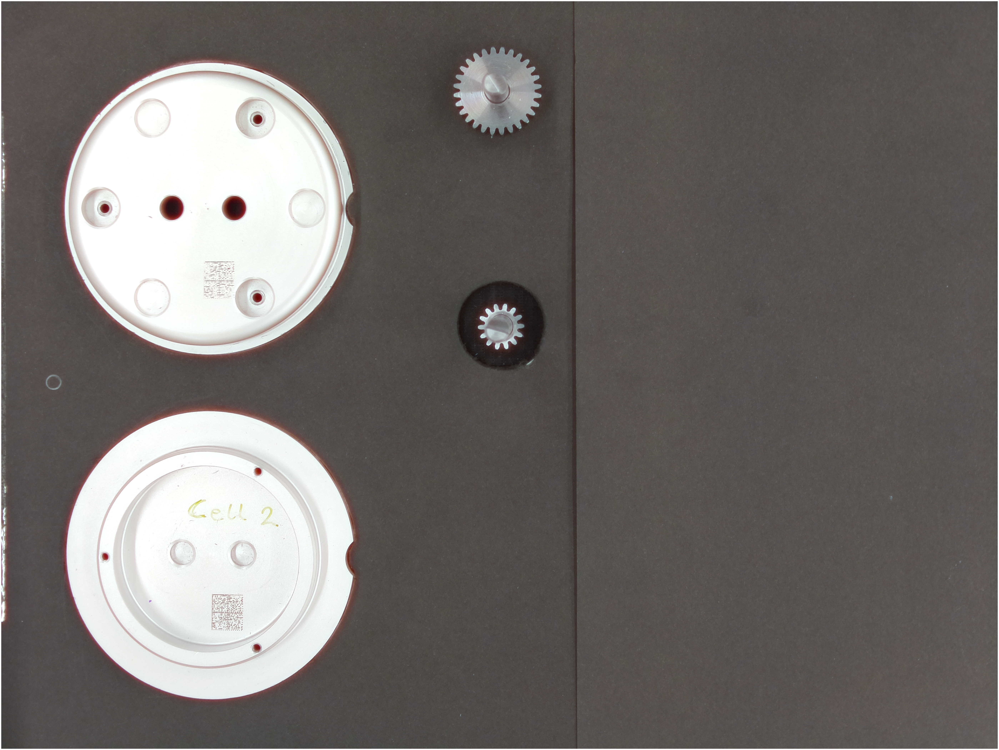

In [31]:
ds=100
plt.figure(figsize = (ds,ds))
plt.imshow(img_rgb)
plt.axis('off')
plt.show()

In [146]:
img_grey = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

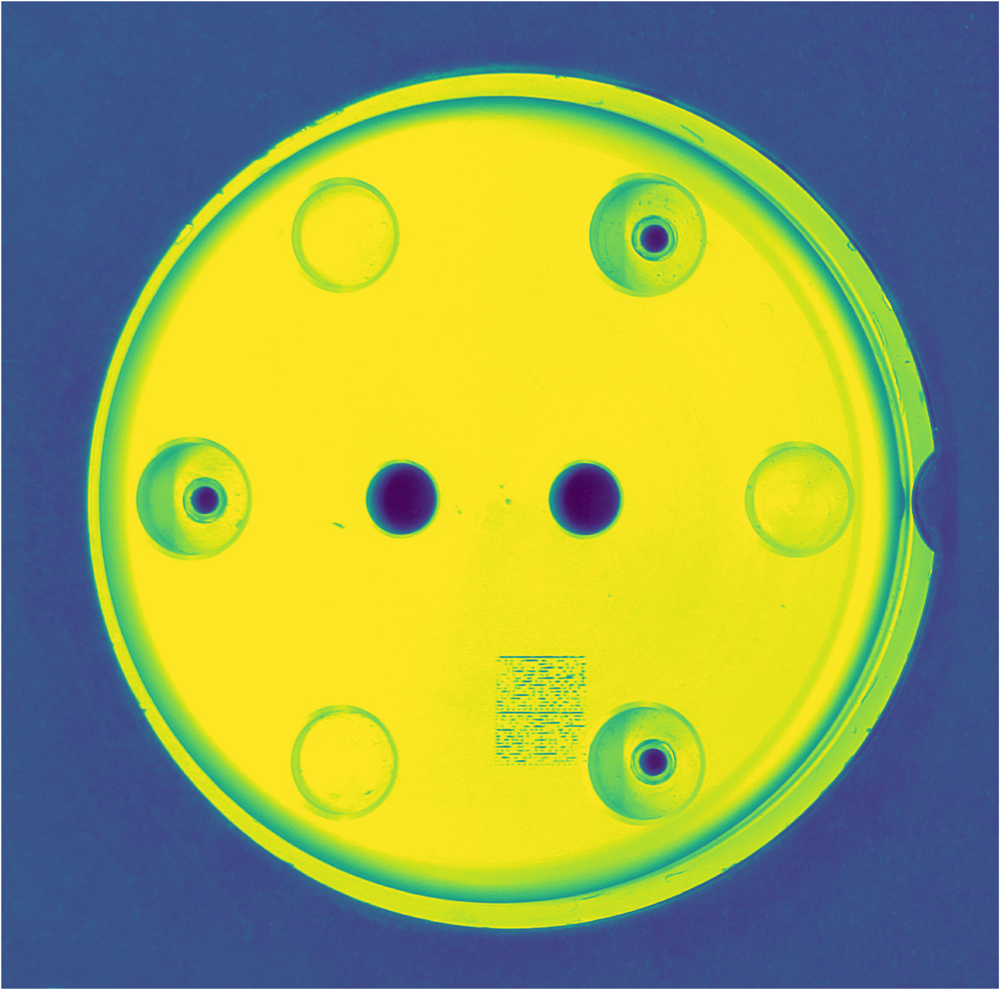

In [73]:
img_top_casing = img_grey[120:1200, 110:1200]

# bilateral_filtered_top_casing = cv2.bilateralFilter(img_top_casing, 5, 30, 255)
plt.figure(figsize = (ds,ds))
plt.imshow(img_top_casing)
plt.axis('off')
plt.show()

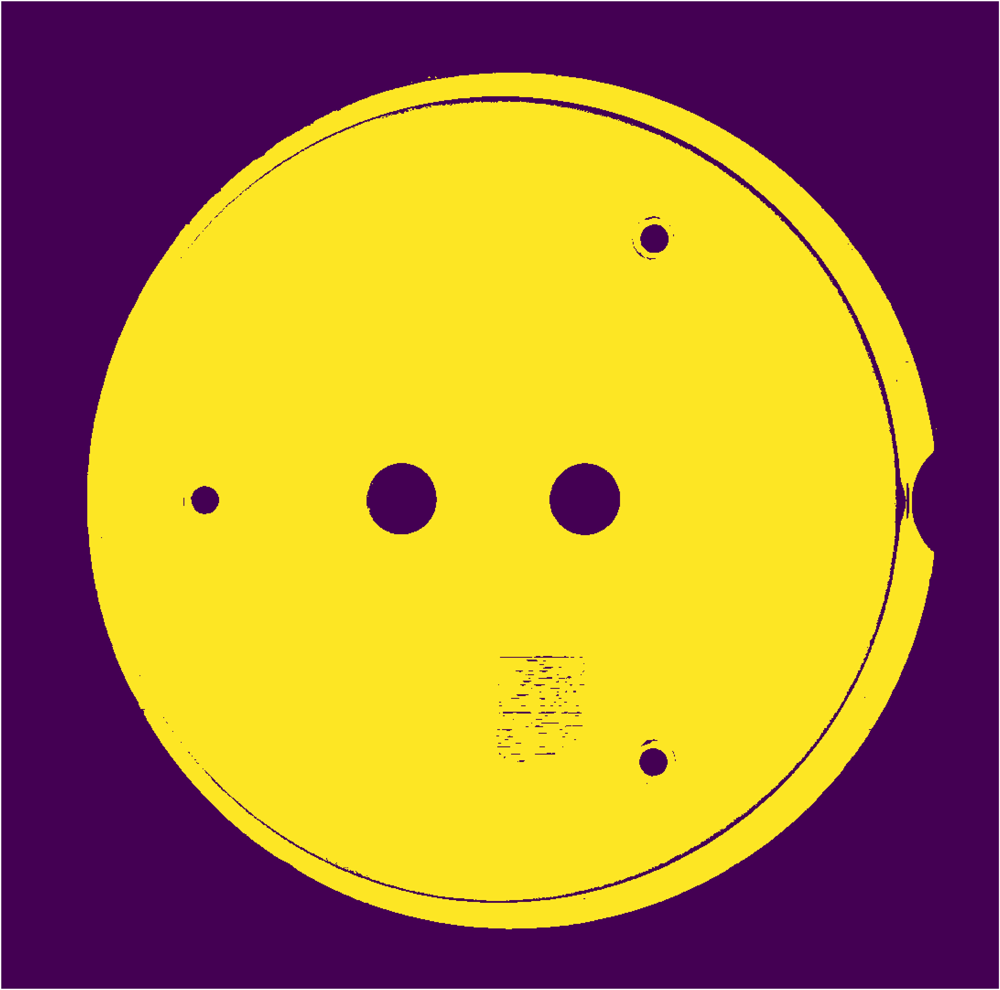

In [74]:
ret, img_top_casing_binary = cv2.threshold(img_top_casing,160,255,cv2.THRESH_BINARY)
plt.figure(figsize = (ds,ds))
plt.imshow(img_top_casing_binary)
plt.axis('off')
plt.show()

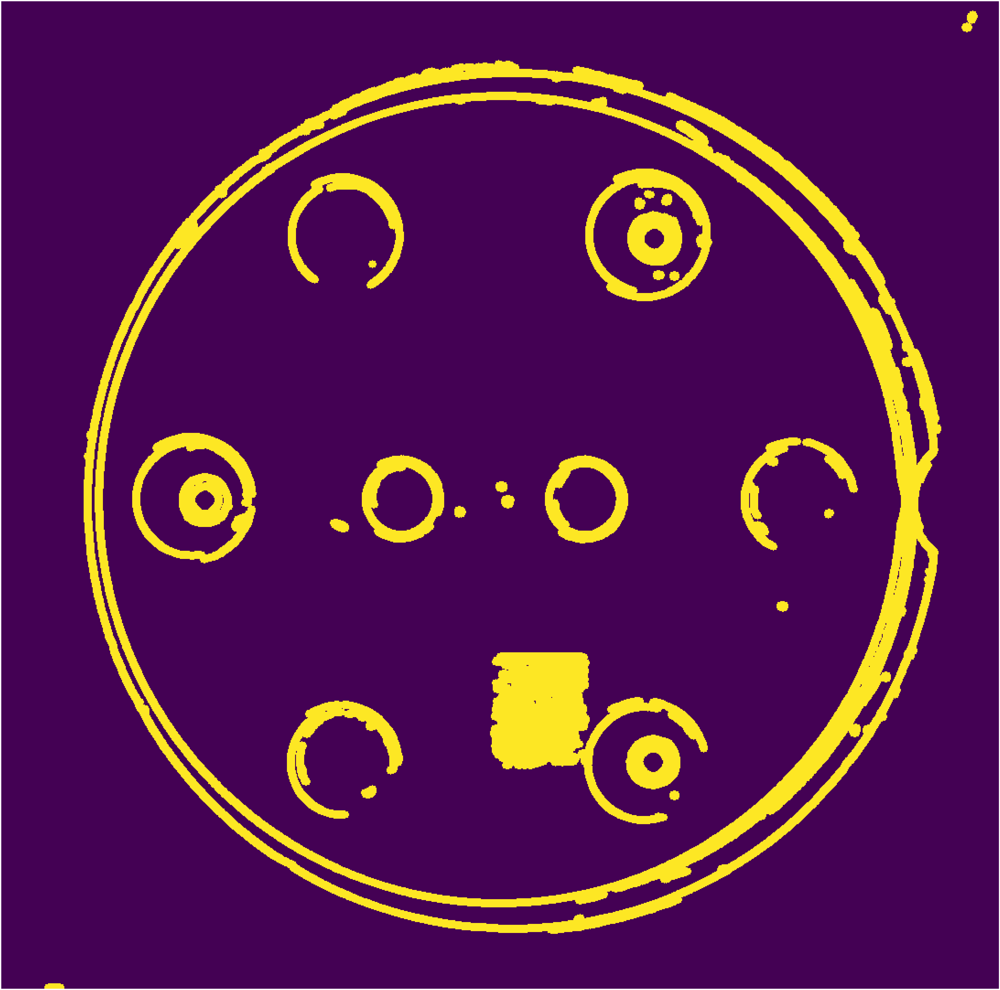

In [52]:
img_top_casing_canny = cv2.Canny(img_top_casing, 75, 150)
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(9,9))
dilated = cv2.dilate(img_top_casing_canny, kernel)
plt.figure(figsize = (ds,ds))
plt.imshow(dilated)
plt.axis('off')
plt.show()

In [75]:
contours, hierarchy = cv2.findContours(img_top_casing_binary, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
contour_list = []
outer_contour = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 0.01 * cv2.arcLength(contour, True), True)
    area = cv2.contourArea(contour)
    if 679000 < area:
        outer_contour = contour
    if 4000 < area < 5600:
        contour_list.append(contour)

(x,y),main_radius = cv2.minEnclosingCircle(outer_contour)
each_pixel = 50 / main_radius

diameters = []

for i in range(len(contour_list)):
    (x,y),radius = cv2.minEnclosingCircle(contour_list[i])
    hole_diameter = radius * 2 * each_pixel
    diameters.append(hole_diameter)

    M = cv2.moments(contour_list[i])
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])
    cv2.putText(img_top_casing, text= f'{diameters[i]:.2f}', org=(cx+50,cy),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,0,0),
            thickness=2, lineType=cv2.LINE_AA)
    # print(hole_diameter)

# 100, 8.2
msg = "Total holes: {}".format(len(contour_list))
cv2.putText(img_top_casing, msg, (20, 40), cv2.FONT_HERSHEY_PLAIN, 2, (0, 0, 0), 2, cv2.LINE_AA)

cv2.drawContours(img_top_casing, contour_list, -1, (0, 255, 0), 2)
cv2.imshow('Objects Detected', img_top_casing)
cv2.waitKey(0)
cv2.destroyAllWindows()

# plt.figure(figsize = (ds,ds))
# plt.imshow(img_top_casing)
# plt.axis('off')
# plt.show()

# cv2.imwrite("detected_holes.png", img)

# cv2.waitKey(0)

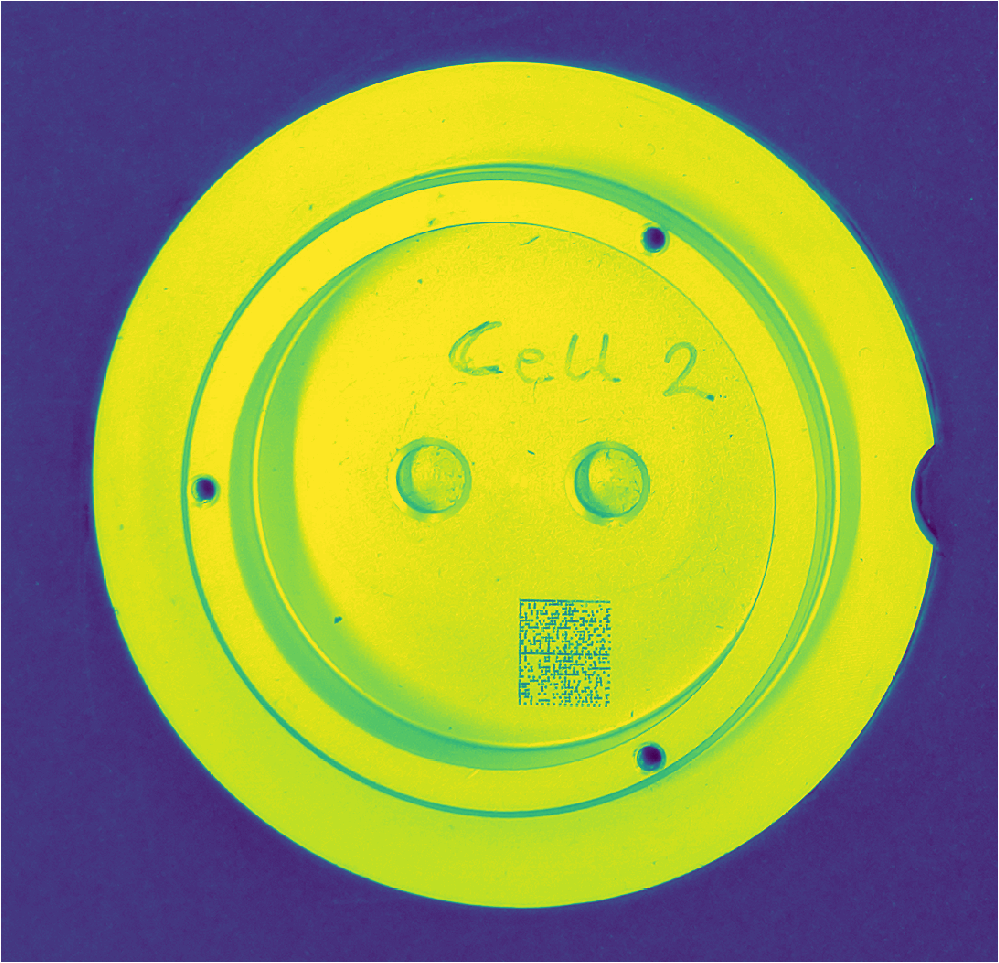

In [101]:
img_bottom_casing = img_grey[1250:2300,110:1200]
img_bottom_casing = cv2.convertScaleAbs(img_bottom_casing, alpha=0.5, beta=0)
plt.figure(figsize = (ds,ds))
plt.imshow(img_bottom_casing)
plt.axis('off')
plt.show()

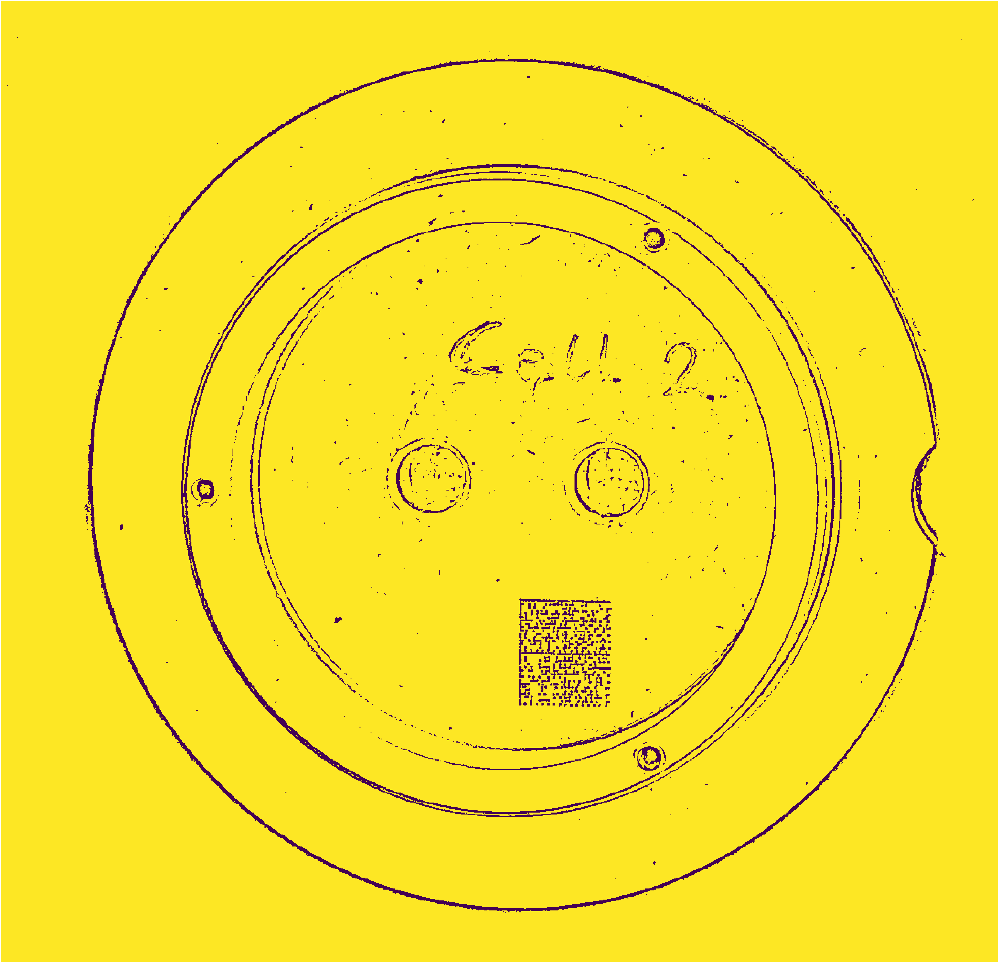

In [102]:
img_bottom_casing_adaptive = cv2.adaptiveThreshold(img_bottom_casing,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,15, 5)
plt.figure(figsize = (ds,ds))
plt.imshow(img_bottom_casing_adaptive)
plt.axis('off')
plt.show()

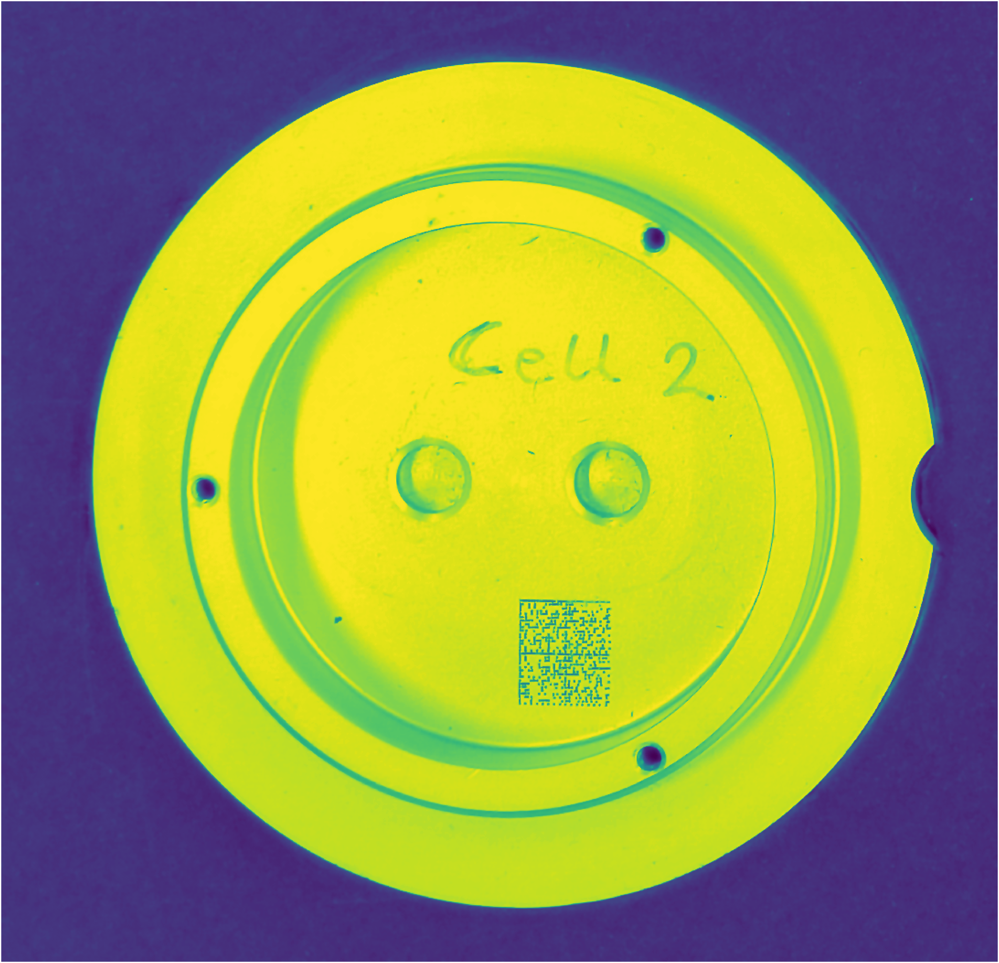

In [78]:
bilateral_filtered_bottom_casing = cv2.bilateralFilter(img_bottom_casing, 5, 20, 300)
plt.figure(figsize = (ds,ds))
plt.imshow(bilateral_filtered_bottom_casing)
plt.axis('off')
plt.show()

In [82]:
rows = bilateral_filtered_bottom_casing.shape[0]
circles = cv2.HoughCircles(bilateral_filtered_bottom_casing, cv2.HOUGH_GRADIENT, 1, rows / 8,
                            param1=200, param2=100,
                            minRadius=0, maxRadius=00)
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        center = (i[0], i[1])
        # circle center
        cv2.circle(bilateral_filtered_bottom_casing, center, 1, (0, 100, 100), 3)
        # circle outline
        radius = i[2]
        cv2.circle(bilateral_filtered_bottom_casing, center, radius, (255, 0, 255), 3)

cv2.imshow("detected circles", bilateral_filtered_bottom_casing)
cv2.waitKey(0)
cv2.destroyAllWindows()

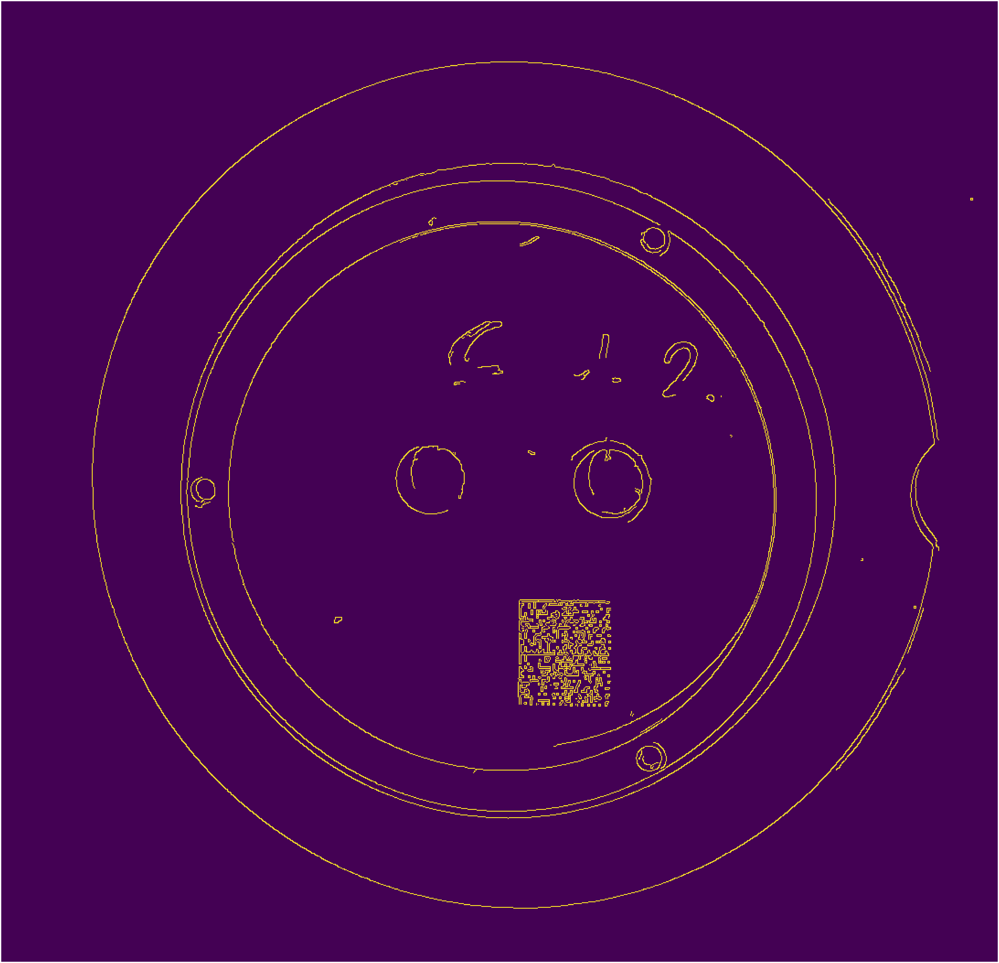

In [79]:
img_bottom_casing_canny = cv2.Canny(bilateral_filtered_bottom_casing, 50, 200)
plt.figure(figsize = (ds,ds))
plt.imshow(img_bottom_casing_canny)
plt.axis('off')
plt.show()

In [ ]:
contours, hierarchy = cv2.findContours(img_bottom_casing_canny, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
contour_list = []
outer_contour = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 0.01 * cv2.arcLength(contour, True), True)
    area = cv2.contourArea(contour)
    if 797000 < area:
        outer_contour = contour
    if 1000 < area < 5600:
        contour_list.append(contour)
    if 790 < area < 820:
        contour_list.append(contour)

(x,y),main_radius = cv2.minEnclosingCircle(outer_contour)
each_pixel = 50 / main_radius

diameters = []

for i in range(len(contour_list)):
    (x,y),radius = cv2.minEnclosingCircle(contour_list[i])
    hole_diameter = radius * 2 * each_pixel
    diameters.append(hole_diameter)

    M = cv2.moments(contour_list[i])
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])
    cv2.putText(img_top_casing, text= str(diameters[i]), org=(cx+50,cy),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,0,0),
            thickness=2, lineType=cv2.LINE_AA)
    # print(hole_diameter)

# 100, 8.2
msg = "Total holes: {}".format(len(contour_list))
cv2.putText(img_top_casing, msg, (20, 40), cv2.FONT_HERSHEY_PLAIN, 2, (0, 0, 0), 2, cv2.LINE_AA)

cv2.drawContours(img_top_casing, contour_list, -1, (0, 255, 0), 2)
cv2.imshow('Objects Detected', img_top_casing)
cv2.waitKey(0)
cv2.destroyAllWindows()

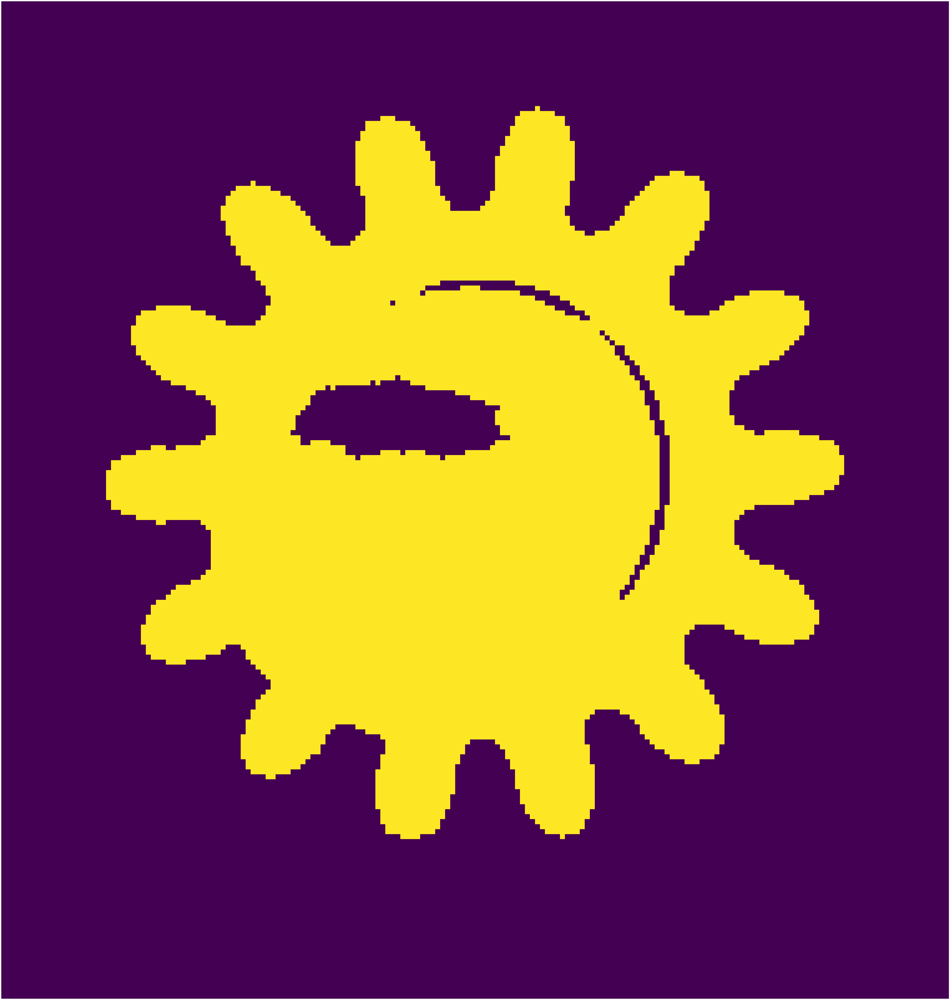

In [112]:
img_small_gear = img_grey[950:1150, 1510:1700]
# img_small_gear_temp = cv2.convertScaleAbs(img_small_gear_temp, alpha=5, beta=0)
# img_small_gear = cv2.convertScaleAbs(img_small_gear_temp, alpha=1.5, beta=0)
# kernel30 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(30,30))
# img_small_gear = cv2.morphologyEx(img_small_gear, cv2.MORPH_TOPHAT, kernel30)
ret, img_small_gear_binary = cv2.threshold(img_small_gear,110,255,cv2.THRESH_BINARY)
img_small_gear_binary = cv2.morphologyEx(img_small_gear_binary, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(9,9)))
# bilateral_filtered_large_gear = cv2.bilateralFilter(img_large_gear, 5, 175, 300)
plt.figure(figsize = (ds,ds))
plt.imshow(img_small_gear_binary)
plt.axis('off')
plt.show()

In [138]:
contours, hierarchy = cv2.findContours(img_small_gear_binary, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
contour_list = []
outer_contour = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 0.01 * cv2.arcLength(contour, True), True)
    area = cv2.contourArea(contour)
    if 12000 < area:
        outer_contour = contour

centre,main_radius = cv2.minEnclosingCircle(outer_contour)
main_radius -= 8

blank = np.full((img_small_gear.shape[0], img_small_gear.shape[1]), 0, dtype=np.uint8)
img1 = cv2.circle(blank.copy(),(int(centre[0]),int(centre[1])), int(main_radius), 20, 2)
img2 = cv2.drawContours(blank.copy(), outer_contour, -1, 20, 2)
intersection = img1 + img2
ret, intersection = cv2.threshold(intersection,30,255,cv2.THRESH_BINARY)

cnts = cv2.findContours(intersection, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

print(f'Intersections: {len(cnts)}')
print(f'Teeth: {len(cnts)/2}')
# diameters = []

# for i in range(len(contour_list)):
#     (x,y),radius = cv2.minEnclosingCircle(contour_list[i])
#     hole_diameter = radius * 2 * each_pixel
#     diameters.append(hole_diameter)

#     M = cv2.moments(contour_list[i])
#     cx = int(M['m10']/M['m00'])
#     cy = int(M['m01']/M['m00'])
#     cv2.putText(img_top_casing, text= f'{diameters[i]:.2f}', org=(cx+50,cy),
#             fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,0,0),
#             thickness=2, lineType=cv2.LINE_AA)
#     # print(hole_diameter)

# # 100, 8.2
# msg = "Total holes: {}".format(len(contour_list))
# cv2.putText(img_top_casing, msg, (20, 40), cv2.FONT_HERSHEY_PLAIN, 2, (0, 0, 0), 2, cv2.LINE_AA)

# cv2.imshow('Objects Detected', intersection)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

74.58226776123047
Intersections: 28
Teeth: 14.0


In [ ]:
ret2,img_binary = cv2.threshold(img_small_gear,15,255,cv2.THRESH_BINARY)
plt.figure(figsize = (ds,ds))
plt.imshow(img_binary)
plt.axis('off')
plt.show()

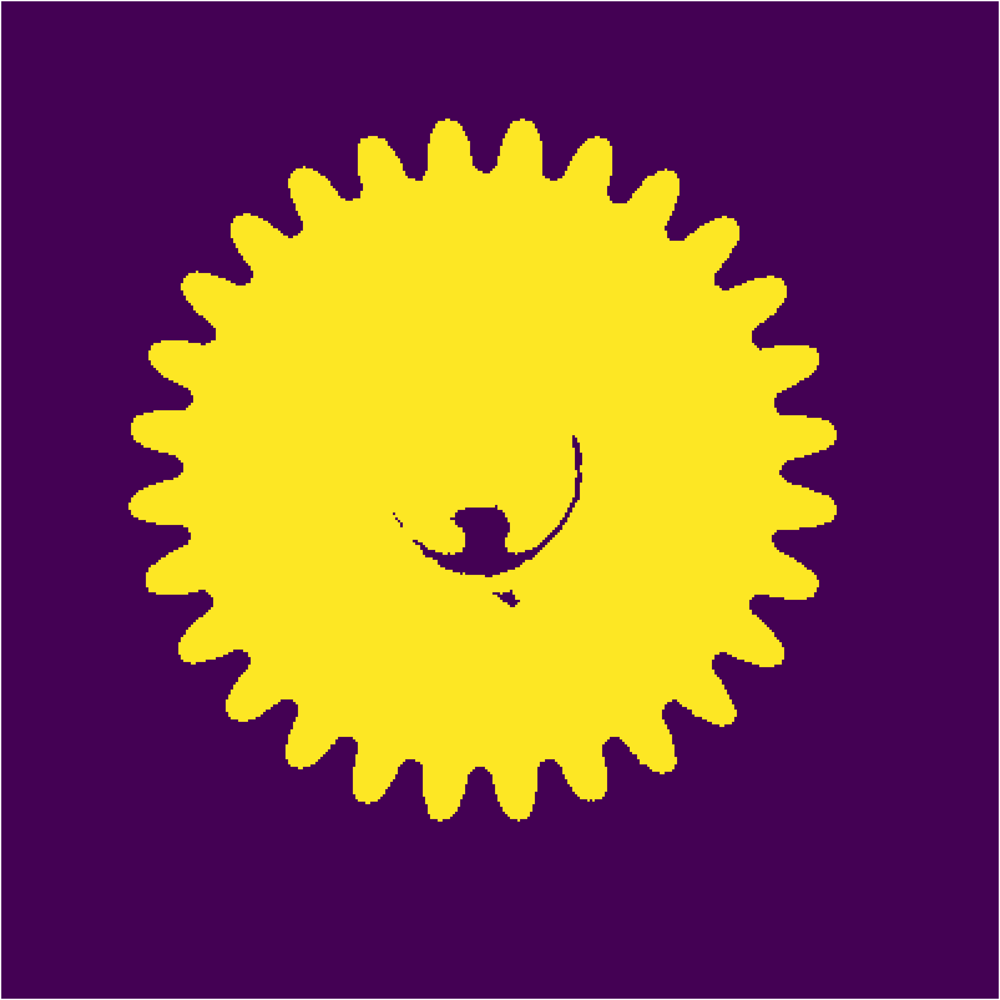

In [148]:
img_large_gear = img_grey[100:500, 1400:1800]
ret, img_large_gear_binary = cv2.threshold(img_large_gear,100,255,cv2.THRESH_BINARY)
img_large_gear_binary = cv2.morphologyEx(img_large_gear_binary, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(9,9)))
# bilateral_filtered_large_gear = cv2.bilateralFilter(img_large_gear, 5, 175, 300)
plt.figure(figsize = (ds,ds))
plt.imshow(img_large_gear_binary)
plt.axis('off')
plt.show()

In [152]:
contours, hierarchy = cv2.findContours(img_large_gear_binary, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
contour_list = []
outer_contour = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 0.01 * cv2.arcLength(contour, True), True)
    area = cv2.contourArea(contour)
    if 50000 < area:
        outer_contour = contour

centre,main_radius = cv2.minEnclosingCircle(outer_contour)
main_radius -= 10

blank = np.full((img_large_gear.shape[0], img_large_gear.shape[1]), 0, dtype=np.uint8)
img1 = cv2.circle(blank.copy(),(int(centre[0]),int(centre[1])), int(main_radius), 20, 2)
img2 = cv2.drawContours(blank.copy(), outer_contour, -1, 20, 2)
intersection = img1 + img2
ret, intersection = cv2.threshold(intersection,30,255,cv2.THRESH_BINARY)

cnts = cv2.findContours(intersection, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

print(f'Intersections: {len(cnts)}')
print(f'Teeth: {len(cnts)/2}')
# diameters = []

# for i in range(len(contour_list)):
#     (x,y),radius = cv2.minEnclosingCircle(contour_list[i])
#     hole_diameter = radius * 2 * each_pixel
#     diameters.append(hole_diameter)

#     M = cv2.moments(contour_list[i])
#     cx = int(M['m10']/M['m00'])
#     cy = int(M['m01']/M['m00'])
#     cv2.putText(img_top_casing, text= f'{diameters[i]:.2f}', org=(cx+50,cy),
#             fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,0,0),
#             thickness=2, lineType=cv2.LINE_AA)
#     # print(hole_diameter)

# # 100, 8.2
# msg = "Total holes: {}".format(len(contour_list))
# cv2.putText(img_top_casing, msg, (20, 40), cv2.FONT_HERSHEY_PLAIN, 2, (0, 0, 0), 2, cv2.LINE_AA)

# cv2.imshow('Objects Detected', intersection)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

142.4053955078125
Intersections: 56
Teeth: 28.0


In [ ]:
ret_large_gear,img_large_gear_global = cv2.threshold(img_large_gear,150,255,cv2.THRESH_BINARY)
img_large_gear_adaptive = cv2.adaptiveThreshold(img_large_gear,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,15, 7)
ret2_large_gear,img_large_gear_otsu = cv2.threshold(img_large_gear,50,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

h,w=img_large_gear.shape
img_large_gear_up = np.concatenate((img_large_gear, img_large_gear_global), axis=1)
img_large_gear_down = np.concatenate((img_large_gear_adaptive, img_large_gear_otsu), axis=1)
img_large_gear_all = np.concatenate((img_large_gear_up, img_large_gear_down), axis=0)
plt.figure(figsize = (ds,ds))
plt.imshow(img_large_gear_all,'gray')
plt.text(w, h, "global=100",fontsize=40)
plt.text(0, h*2, "adaptive",fontsize=40)
plt.text(w, h*2, "otsu",fontsize=40)
plt.axis('off')
plt.show()

In [ ]:
img_grey = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
plt.figure(figsize = (ds,ds))
plt.imshow(img_grey,'gray')
plt.axis('off')
plt.show()

In [ ]:
img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
plt.figure(figsize = (ds,ds))
plt.imshow(img_hsv)
plt.axis('off')
plt.show()

In [ ]:
lower = np.array([36,25,25])
upper = np.array([70,255,255])
img_color = cv2.inRange(img_hsv, lower, upper)
plt.figure(figsize = (ds,ds))
plt.imshow(img_color)
plt.axis('off')
plt.show()

In [ ]:
ksize=5
img_pro = cv2.GaussianBlur(img_grey,(ksize,ksize),0)
plt.figure(figsize = (ds,ds))
plt.imshow(img_pro)
plt.axis('off')
plt.show()

In [ ]:
ret,img_global = cv2.threshold(img_pro,150,255,cv2.THRESH_BINARY)
img_adaptive = cv2.adaptiveThreshold(img_pro,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,15, 5)
ret2,img_otsu = cv2.threshold(img_pro,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

In [ ]:
h,w=img_grey.shape
img_up = np.concatenate((img_grey, img_global), axis=1)
img_down = np.concatenate((img_adaptive, img_otsu), axis=1)
img_all = np.concatenate((img_up, img_down), axis=0)
plt.figure(figsize = (ds,ds))
plt.imshow(img_all,'gray')
plt.text(w, h, "global=100",fontsize=40)
plt.text(0, h*2, "adaptive",fontsize=40)
plt.text(w, h*2, "otsu",fontsize=40)
plt.axis('off')
plt.show()

In [ ]:
img_adaptive = cv2.adaptiveThreshold(img_pro,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,15, 6)
plt.figure(figsize = (ds,ds))
plt.imshow(img_adaptive)
plt.axis('off')
plt.show()

In [ ]:
contours,hierarchy = cv2.findContours(img_adaptive,cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE )
print(hierarchy)

In [ ]:
contour_filter=[]
img_contour=img_rgb.copy()
for i,contour in enumerate(contours):
    if hierarchy[0][i][3]!=-1:
        cv2.drawContours(img_contour, [contour], -1, (0,0,255), 10)  
        contour_filter.append(contour)
print(contour_filter)

In [ ]:
plt.figure(figsize = (ds,ds))
plt.imshow(img_contour)
plt.axis('off')
plt.show()